In [1]:
import pylab
import pandas as pd
df = pd.read_csv("events_train_holdout.tsv", na_values=['-'], delimiter="\t", error_bad_lines=False)

b'Skipping line 45149: expected 13 fields, saw 15\n'


In [2]:
df.describe()

/Users/abhisheknigam/anaconda/lib/python3.5/site-packages/numpy/lib/function_base.py:3834: RuntimeWarning: Invalid value encountered in percentile
  RuntimeWarning)


,latitude,longitude,number_of_responders,lanes_affected
count,653486.000000,653486.000000,651269.000000,323298.000000
mean,38.626247,-76.734431,0.936435,1.225928
std,6.792310,4.537582,1.475639,1.348536
min,-77.156882,-79.468413,0.000000,0.000000
25%,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN
max,39.430725,5.000000,41.000000,28.000000


In [3]:
df.columns

Index(['event_id', 'event_description', 'start_tstamp', 'confirmed_tstamp',
       'created_tstamp', 'closed_tstamp', 'event_type', 'event_subtype',
       'location', 'latitude', 'longitude', 'number_of_responders',
       'lanes_affected'],
      dtype='object')

In [4]:
clean_TS = df[df["created_tstamp"].isnull() == False]
clean_TS = clean_TS[clean_TS["created_tstamp"] != "NaN"]

In [5]:
clean_TS = clean_TS[clean_TS["created_tstamp"] != "0"]
clean_TS = clean_TS[clean_TS["created_tstamp"] != "1"]
clean_TS = clean_TS[clean_TS["created_tstamp"] != "2"]
clean_TS = clean_TS[clean_TS["created_tstamp"] != "3"]
clean_TS = clean_TS[clean_TS["created_tstamp"] != "4"]
clean_TS = clean_TS[clean_TS["created_tstamp"] != "5"]

In [6]:
clean_TS.tail(100)

clean_TS["event_type"].unique()

## accidentsAndIncidents
## road maintenance operations
## trafficConditions

array(['accidentsAndIncidents', 'obstruction', 'trafficConditions',
       'roadwork', 'DelayStatusCancellation', 'disasters', 'precipitation',
       'deviceStatus', 'traffic lights not working', 'minor accident',
       'accident', 'disabled vehicle', 'hazardous material spill',
       'disturbances', 'incident', 'fallen trees', 'abandoned vehicle',
       'debris on roadway', 'work on underground services',
       'water main work', 'specialEvents', 'security incident',
       'pavementConditions', 'sportingEvents', 'incidentResponseEquipment',
       'major event', 'traffic congestion', 'sign down',
       'road maintenance operations', 'warningAdvice', 'winds',
       'overgrown grass', 'visibilityAndAirQuality'], dtype=object)

In [7]:
clean_TS['hours'] = clean_TS.apply(lambda row: float(row['created_tstamp'].split("T")[1].split(":")[0]), axis=1)

In [8]:
hour_grouped = clean_TS.groupby('hours')

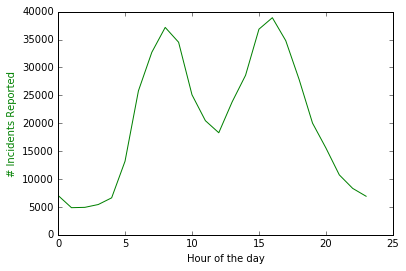

In [9]:
%matplotlib inline
import matplotlib.pyplot as pp

fig, ax1 = pp.subplots()
x = hour_grouped.size().index
ax1.plot(x, hour_grouped.size(), 'g-')
ax1.set_xlabel('Hour of the day')
ax1.set_ylabel('# Incidents Reported', color='g')

In [10]:
clean_TS.tail(100)

,event_id,event_description,start_tstamp,confirmed_tstamp,created_tstamp,closed_tstamp,event_type,event_subtype,location,latitude,longitude,number_of_responders,lanes_affected,hours
657662,VaTraffic_INNO4290267-12312013,Fairfax (County) - Rt. 644W (Fairfax County) -...,2013-12-31T13:57:38-05:00,NaN,2013-12-31T13:57:38-05:00,2013-12-31T15:11:52-05:00,accidentsAndIncidents,accident,NaN,38.778732,-77.189088,0.0,1.0,13.0
657663,MDOT_CHART_d5ffe6ba901407c30052fa2ec4235c0a,Incident @ I-270 NORTH PRIOR TO EXIT 11 MD 124...,2013-12-31T14:02:18-05:00,2013-12-31T14:02:18-05:00,2013-12-31T14:02:18-05:00,2013-12-31T14:30:35-05:00,obstruction,debris on roadway,I-270 NORTH PRIOR TO EXIT 11 MD 124 QUINCE ORC...,39.148556,-77.216640,1.0,0.0,14.0
657664,MDOT_CHART_f9fff4d0901407c30052fa2ec4235c0a,Disabled Vehicle Event @ I-695 INNER LOOP PRIO...,2013-12-31T14:02:40-05:00,2013-12-31T14:02:40-05:00,2013-12-31T14:02:40-05:00,2013-12-31T14:07:24-05:00,accidentsAndIncidents,disabled vehicle,I-695 INNER LOOP PRIOR TO EXIT 33 I 95,39.352144,-76.496616,1.0,NaN,14.0
657665,MDOT_CHART_410012f9911407c30052fa2ec4235c0a,Disabled Vehicle Event @ US 50 EAST PRIOR TO M...,2013-12-31T14:03:21-05:00,2013-12-31T14:03:21-05:00,2013-12-31T14:03:21-05:00,2013-12-31T14:05:02-05:00,accidentsAndIncidents,disabled vehicle,US 50 EAST PRIOR TO MD 665,38.982379,-76.555060,1.0,NaN,14.0
657666,MDOT_CHART_f2004674911607c30052fa2ec4235c0a,Disabled Vehicle Event @ US 29 NORTH AT EXIT 1...,2013-12-31T14:09:40-05:00,2013-12-31T14:09:40-05:00,2013-12-31T14:09:40-05:00,2013-12-31T14:10:35-05:00,accidentsAndIncidents,disabled vehicle,US 29 NORTH AT EXIT 17 SENECA DR,39.189948,-76.868952,1.0,NaN,14.0
657667,MDOT_CHART_e0006443911707c30052fa2ec4235c0a,Incident @ MD 295 SOUTH PRIOR TO MD 193 [Colli...,2013-12-31T14:13:07-05:00,2013-12-31T14:13:07-05:00,2013-12-31T14:13:07-05:00,2013-12-31T15:13:46-05:00,accidentsAndIncidents,injury accident,MD 295 SOUTH PRIOR TO MD 193,38.994821,-76.880912,4.0,0.0,14.0
657668,MDOT_CHART_71ff9b99911b07c30052fa2ec4235c0a,Incident @ I-95X INNER LOOP PRIOR TO EXIT 27 I...,2013-12-31T14:31:37-05:00,2013-12-31T14:31:37-05:00,2013-12-31T14:31:37-05:00,2013-12-31T14:51:30-05:00,obstruction,debris on roadway,I-95X INNER LOOP PRIOR TO EXIT 27 I 495,39.029500,-76.948192,2.0,NaN,14.0
657669,MDOT_CHART_fdffc5fa911c07c30052fa2ec4235c0a,Disabled Vehicle Event @ I-695 INNER LOOP AT H...,2013-12-31T14:37:30-05:00,2013-12-31T14:37:56-05:00,2013-12-31T14:37:30-05:00,2013-12-31T14:43:53-05:00,accidentsAndIncidents,disabled vehicle,I-695 INNER LOOP AT HARFORD RD,39.388380,-76.530282,1.0,NaN,14.0
657670,VDOT_NOVA_NOVA4290523,NaN,2013-12-31T14:40:06-05:00,2013-12-31T14:42:02-05:00,2013-12-31T14:42:02-05:00,2013-12-31T15:22:22-05:00,accidentsAndIncidents,vehicle on fire,NaN,38.867980,-77.220340,5.0,0.0,14.0
657671,VaTraffic_INNO4290523-12312013,Fairfax (County) - I-495S - 50.0 - South - the...,2013-12-31T14:42:02-05:00,NaN,2013-12-31T14:42:02-05:00,2013-12-31T15:19:39-05:00,accidentsAndIncidents,vehicle on fire,NaN,38.867980,-77.220336,0.0,2.0,14.0


In [11]:
import numpy as np
def split_year(row):
    val = str(row['created_tstamp'])
    val1 = str(row['start_tstamp'])
    val2 = str(row['confirmed_tstamp'])
    if "-" in val: 
        return val.split('T')[0].split('-')[0]
    if "-" in val1: 
        return val1.split('T')[0].split('-')[0]
    if "-" in val2: 
        return val2.split('T')[0].split('-')[0]
        
        
clean_TS['new_year'] = df.apply(lambda row: split_year(row), axis=1)
year_grouped = clean_TS.groupby('new_year')

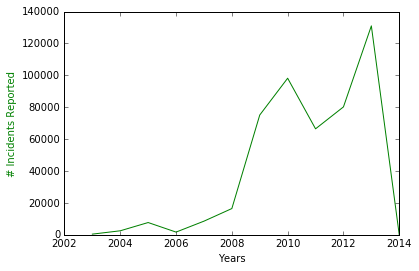

In [92]:
fig, ax1 = pp.subplots()
x = year_grouped.size().index
ax1.plot(x, year_grouped.size(), 'g-')
ax1.set_xlabel('Years')
ax1.set_ylabel('# Incidents Reported', color='g')

In [13]:
year_grouped.head()

,event_id,event_description,start_tstamp,confirmed_tstamp,created_tstamp,closed_tstamp,event_type,event_subtype,location,latitude,longitude,number_of_responders,lanes_affected,hours,new_year
0,MDOT_CHART_4aff02b300110095003f0be8b3035daa,Action Event @ BWI Parking,NaN,NaN,2003-10-21T06:58:06-04:00,2003-11-26T18:27:23-05:00,accidentsAndIncidents,incident,BWI Parking,39.181837,-76.672123,0.0,NaN,6.0,2003
1,MDOT_CHART_4fffe16700a60095003f04e897035daa,Incident @ I-95 PRIOR MD 202[Vehicle Fire],NaN,NaN,2003-10-21T17:26:49-04:00,2003-10-21T18:23:39-04:00,accidentsAndIncidents,vehicle on fire,I-95 PRIOR MD 202,38.916545,-76.851412,6.0,1.0,17.0,2003
2,MDOT_CHART_89ff153200d70096003f05e89f035daa,"Incident @ N/B I-97 AT MD 100[Collision, Perso...",NaN,NaN,2003-10-22T15:13:05-04:00,2003-10-22T15:59:36-04:00,accidentsAndIncidents,incident,N/B I-97 AT MD 100,39.152326,-76.644871,4.0,1.0,15.0,2003
3,MDOT_CHART_0aff378a01e50096003f05e897035daa,Incident @ I-270 N. OF SHADY GROVE RD[Debris I...,NaN,2003-10-22T16:17:01-04:00,2003-10-22T16:14:56-04:00,2003-10-22T16:26:23-04:00,obstruction,debris on roadway,I-270 N. OF SHADY GROVE RD,39.113290,-77.190120,2.0,NaN,16.0,2003
4,MDOT_CHART_9aff47fb01f40096003f05e897035daa,"Incident @ MD 320 AT SLIGO AVE[Collision, Fata...",NaN,2003-10-22T17:23:45-04:00,2003-10-22T17:21:40-04:00,2003-10-22T21:01:59-04:00,accidentsAndIncidents,accident,MD 320 AT SLIGO AVE,38.991634,-77.010207,8.0,6.0,17.0,2003
419,MDOT_CHART_67ff82ce005500f5003f05e897035daa,"Incident @ MD 355 AT MARINELLI D[Collision, Pe...",NaN,2004-01-02T07:14:22-05:00,2004-01-02T06:27:47-05:00,2004-01-02T20:17:23-05:00,accidentsAndIncidents,accident,MD 355 AT MARINELLI DR,39.046810,-77.112337,4.0,2.0,6.0,2004
420,MDOT_CHART_c9003853007d00f5003f04e897035daa,"Incident @ MD ROUTE 5 AT AUTH RO[Collision, Pr...",NaN,2004-01-02T09:17:38-05:00,2004-01-02T09:14:36-05:00,2004-01-02T22:42:23-05:00,accidentsAndIncidents,accident,MD ROUTE 5 AT AUTH ROAD,38.820614,-76.920377,3.0,1.0,9.0,2004
421,MDOT_CHART_dbff064900c200f5003f05e89f035daa,Disabled Vehicle Event @ O/L I-695 MD 150,NaN,NaN,2004-01-02T14:12:19-05:00,2004-01-02T14:42:34-05:00,accidentsAndIncidents,disabled vehicle,O/L I-695 MD 150,39.296734,-76.502814,1.0,NaN,14.0,2004
422,MDOT_CHART_c200325100c500f5003f17e83d035daa,Disabled Vehicle Event @ I-95 @ EXIT 57 BOSTON...,NaN,2004-01-02T14:44:38-05:00,2004-01-02T14:24:32-05:00,2004-01-02T14:44:54-05:00,accidentsAndIncidents,disabled vehicle,I-95 @ EXIT 57 BOSTON ST R/SH,39.267601,-76.558829,1.0,NaN,14.0,2004
423,MDOT_CHART_65ff169000d600f6003f8fe833035daa,"Incident @ I-495 RAMP TO US 50 E[Collision, Pe...",NaN,2004-01-03T09:50:35-05:00,2004-01-03T09:51:35-05:00,2004-01-03T23:32:23-05:00,accidentsAndIncidents,accident,I-495 RAMP TO US 50 EB,38.944358,-76.854908,2.0,1.0,9.0,2004


In [14]:
clean_TS_AI = clean_TS[clean_TS['event_type'] == 'accidentsAndIncidents']
AI_grouped = clean_TS_AI.groupby('hours')

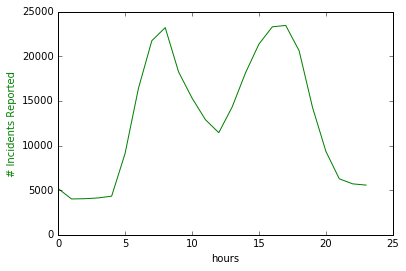

In [15]:
fig, ax1 = pp.subplots()
x = AI_grouped.size().index
ax1.plot(x, AI_grouped.size(), 'g-')
ax1.set_xlabel('hours')
ax1.set_ylabel('# Incidents Reported', color='g')

In [121]:
import mplleaflet
pp.figure(figsize=(10,10))
pp.hold(True)
pp.plot(clean_TS_AI['longitude'], clean_TS_AI['latitude'], 'rs') # Draw red squares
mplleaflet.display()

In [122]:
clean_TS_AI = clean_TS[clean_TS['event_type'] == 'obstruction']
AI_grouped = clean_TS_AI.groupby('hours')

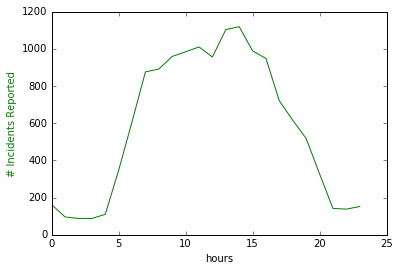

In [123]:
fig, ax1 = pp.subplots()
x = AI_grouped.size().index
ax1.plot(x, AI_grouped.size(), 'g-')
ax1.set_xlabel('hours')
ax1.set_ylabel('# Incidents Reported', color='g')

In [124]:
clean_TS_AI = clean_TS[clean_TS['event_type'] == 'trafficConditions']
AI_grouped = clean_TS_AI.groupby('hours')

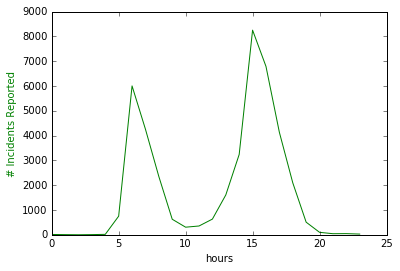

In [125]:
fig, ax1 = pp.subplots()
x = AI_grouped.size().index
ax1.plot(x, AI_grouped.size(), 'g-')
ax1.set_xlabel('hours')
ax1.set_ylabel('# Incidents Reported', color='g')

In [128]:
pp.figure(figsize=(10,10))
pp.hold(True)
pp.plot(clean_TS_AI['longitude'], clean_TS_AI['latitude'], 'rs') # Draw red squares
mplleaflet.display()

In [22]:
def split_month(row):
    val = str(row['created_tstamp'])
    val1 = str(row['start_tstamp'])
    val2 = str(row['confirmed_tstamp'])
    if "-" in val: 
        return val.split('T')[0].split('-')[1]
    if "-" in val1: 
        return val1.split('T')[0].split('-')[1]
    if "-" in val2: 
        return val2.split('T')[0].split('-')[1]
        
        
clean_TS['new_month'] = df.apply(lambda row: split_month(row), axis=1)
month_grouped = clean_TS.groupby('new_month')

In [32]:
clean_TS_AI = clean_TS[clean_TS['event_type'] == 'disasters']
AI_grouped = clean_TS_AI.groupby('new_month')

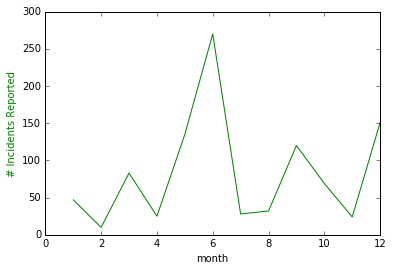

In [33]:
fig, ax1 = pp.subplots()
x = AI_grouped.size().index
ax1.plot(x, AI_grouped.size(), 'g-')
ax1.set_xlabel('month')
ax1.set_ylabel('# Incidents Reported', color='g')

In [46]:
AI_grouped = clean_TS_AI.groupby('event_subtype')
uniqueDisasters = AI_grouped['event_subtype'].unique()

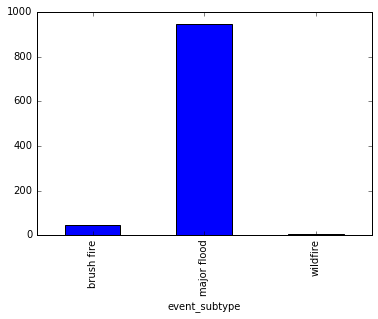

In [47]:
clean_TS_AI.groupby('event_subtype').size().plot.bar()

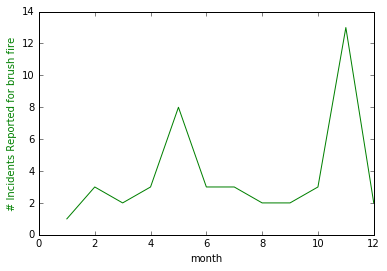

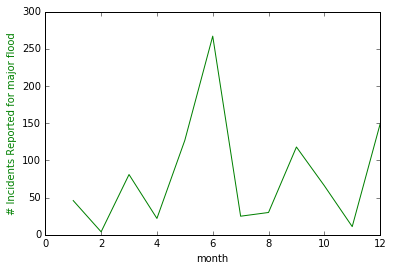

In [112]:
count = 0
for i in uniqueDisasters:
    count = count + 1
    if count == 3:
        continue;
    else:
        p = clean_TS[clean_TS['event_subtype'] == i.item()].groupby('new_month')
        x = p.size().index
        y = p.size()
        fig, ax1 = pp.subplots()
        ax1.plot(x, y, 'g-')
        ax1.set_xlabel('month')
        ax1.set_ylabel('# Incidents Reported for ' + i.item(), color='g')
    
    

In [97]:
df_lane = pd.read_csv("detector_lane_inventory.tsv", na_values=['-'], delimiter="\t", error_bad_lines=False)

In [135]:
df_lane

,lane_id,zone_id,lane_number,name,state,road,description,location_description,lane_type,organization,detector_type,latitude,longitude,bearing,default_speed,interval
0,12,1316,1,Lane 1 EB Normal,Northern Virginia,I-66,East,I-66 NEAR Sudley Rd @ MM 49.02,Normal,VDOT_NOVA,Single Loop,38.810540,-77.488933,NaN,65.0,60.0
1,13,1119,2,Lane 2 EB Normal,Northern Virginia,I-66,East,I-66 NEAR Sudley Rd @ MM 49.02,Normal,VDOT_NOVA,Single Loop,38.810509,-77.488910,NaN,65.0,60.0
2,14,1119,3,Lane 3 EB Normal,Northern Virginia,I-66,East,I-66 NEAR Sudley Rd @ MM 49.02,Normal,VDOT_NOVA,Single Loop,38.810478,-77.488888,NaN,65.0,60.0
3,15,1119,4,Lane 4 EB Normal,Northern Virginia,I-66,East,I-66 NEAR Sudley Rd @ MM 49.02,Normal,VDOT_NOVA,Single Loop,38.810453,-77.488871,NaN,65.0,60.0
4,16,1317,1,Lane 1 WB Normal,Northern Virginia,I-66,West,I-66 NEAR Sudley Rd @ MM 49.02,Normal,VDOT_NOVA,Single Loop,38.810790,-77.488638,NaN,65.0,60.0
5,17,1120,2,Lane 2 WB Normal,Northern Virginia,I-66,West,I-66 NEAR Sudley Rd @ MM 49.02,Normal,VDOT_NOVA,Single Loop,38.810819,-77.488657,NaN,65.0,60.0
6,18,1120,3,Lane 3 WB Normal,Northern Virginia,I-66,West,I-66 NEAR Sudley Rd @ MM 49.02,Normal,VDOT_NOVA,Single Loop,38.810849,-77.488675,NaN,65.0,60.0
7,19,1120,4,Lane 4 WB Normal,Northern Virginia,I-66,West,I-66 NEAR Sudley Rd @ MM 49.02,Normal,VDOT_NOVA,Single Loop,38.810880,-77.488693,NaN,65.0,60.0
8,20,1318,1,Lane 1 EB Normal,Northern Virginia,I-66,East,I-66 NEAR Sudley Rd @ MM 49.5,Normal,VDOT_NOVA,Single Loop,38.813640,-77.481026,NaN,65.0,60.0
9,21,1121,2,Lane 2 EB Normal,Northern Virginia,I-66,East,I-66 NEAR Sudley Rd @ MM 49.5,Normal,VDOT_NOVA,Single Loop,38.813607,-77.481003,NaN,65.0,60.0


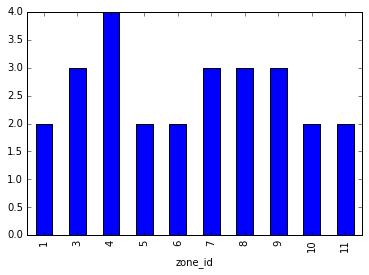

In [138]:
df_lane = pd.read_csv("detector_lane_inventory.tsv", na_values=['-'], delimiter="\t", error_bad_lines=False)
max_used = df_lane.groupby('zone_id').size().head(10).plot.bar()

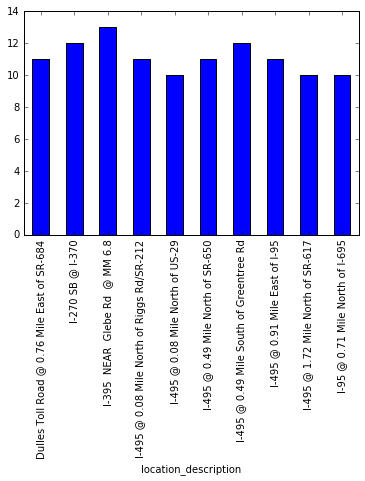

In [102]:
topusedroads.groupby('location_description').size().plot.bar()

In [129]:
import mplleaflet
pp.figure(figsize=(10,10))
pp.hold(True)
pp.plot(topusedroads['longitude'], topusedroads['latitude'], 'rs') # Draw red squares
mplleaflet.display()

In [114]:
!pip3 install mplleaflet

In [115]:
import mplleaflet

In [134]:
cols = ['longitude', 'latitude']
topusedroads['longitude'].unique()

array([-77.077397 , -77.0772774, -77.0772415, -77.0772099, -77.0771744,
       -77.0773633, -76.673998 , -77.21344  , -77.15188  , -77.21902  ,
       -77.22052  , -77.15849  , -76.96571  , -77.21981  , -77.195727 ,
       -77.196643 , -77.078036 ])